# SAM: Inference Playground

In [4]:
import os
os.chdir('/content')
CODE_DIR = 'SAM'

In [5]:
!git clone https://github.com/yuval-alaluf/SAM.git $CODE_DIR

Cloning into 'SAM'...
remote: Enumerating objects: 228, done.
remote: Counting objects: 100% (48/48), done.
remote: Compressing objects: 100% (26/26), done.
remote: Total 228 (delta 32), reused 22 (delta 22), pack-reused 180 (from 1)
Receiving objects: 100% (228/228), 24.63 MiB | 22.66 MiB/s, done.
Resolving deltas: 100% (78/78), done.


In [6]:
!wget https://github.com/ninja-build/ninja/releases/download/v1.8.2/ninja-linux.zip
!sudo unzip ninja-linux.zip -d /usr/local/bin/
!sudo update-alternatives --install /usr/bin/ninja ninja /usr/local/bin/ninja 1 --force

--2026-01-19 00:49:13--  https://github.com/ninja-build/ninja/releases/download/v1.8.2/ninja-linux.zip
Resolving github.com (github.com)... 140.82.114.3
Connecting to github.com (github.com)|140.82.114.3|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://release-assets.githubusercontent.com/github-production-release-asset/1335132/d2f252e2-9801-11e7-9fbf-bc7b4e4b5c83?sp=r&sv=2018-11-09&sr=b&spr=https&se=2026-01-19T01%3A31%3A26Z&rscd=attachment%3B+filename%3Dninja-linux.zip&rsct=application%2Foctet-stream&skoid=96c2d410-5711-43a1-aedd-ab1947aa7ab0&sktid=398a6654-997b-47e9-b12b-9515b896b4de&skt=2026-01-19T00%3A30%3A48Z&ske=2026-01-19T01%3A31%3A26Z&sks=b&skv=2018-11-09&sig=VXVZ3FJg1KhXBatNxsqPBwwYPCTrEfqOgYoFpJiRADM%3D&jwt=eyJ0eXAiOiJKV1QiLCJhbGciOiJIUzI1NiJ9.eyJpc3MiOiJnaXRodWIuY29tIiwiYXVkIjoicmVsZWFzZS1hc3NldHMuZ2l0aHVidXNlcmNvbnRlbnQuY29tIiwia2V5Ijoia2V5MSIsImV4cCI6MTc2ODc4NDA1MywibmJmIjoxNzY4NzgzNzUzLCJwYXRoIjoicmVsZWFzZWFzc2V0cHJvZHVjdGlvbi5ibG9iLm

In [7]:
os.chdir(f'./{CODE_DIR}')

In [8]:
from argparse import Namespace
import os
import sys
import pprint
import numpy as np
from PIL import Image
import torch
import torchvision.transforms as transforms

sys.path.append(".")
sys.path.append("..")

from datasets.augmentations import AgeTransformer
from utils.common import tensor2im
from models.psp import pSp

In [9]:
EXPERIMENT_TYPE = 'ffhq_aging'

## Step 1: Download Pretrained Model
As part of this repository, we provide our pretrained aging model.
We'll download the model for the selected experiments as save it to the folder `../pretrained_models`.

In [10]:
def get_download_model_command(file_id, file_name):
    """ Get wget download command for downloading the desired model and save to directory ../pretrained_models. """
    current_directory = os.getcwd()
    save_path = os.path.join(os.path.dirname(current_directory), "pretrained_models")
    if not os.path.exists(save_path):
        os.makedirs(save_path)
    url = r"""wget --load-cookies /tmp/cookies.txt "https://docs.google.com/uc?export=download&confirm=$(wget --quiet --save-cookies /tmp/cookies.txt --keep-session-cookies --no-check-certificate 'https://docs.google.com/uc?export=download&id={FILE_ID}' -O- | sed -rn 's/.*confirm=([0-9A-Za-z_]+).*/\1\n/p')&id={FILE_ID}" -O {SAVE_PATH}/{FILE_NAME} && rm -rf /tmp/cookies.txt""".format(FILE_ID=file_id, FILE_NAME=file_name, SAVE_PATH=save_path)
    return url

In [17]:
MODEL_PATHS = {
    "ffhq_aging": {"id": "1XyumF6_fdAxFmxpFcmPf-q84LU_22EMC", "name": "sam_ffhq_aging.pt"}
}

path = MODEL_PATHS[EXPERIMENT_TYPE]

# Install gdown if not already installed
!pip install -qqq gdown

# Define save path
current_directory = os.getcwd()
save_path = os.path.join(os.path.dirname(current_directory), "pretrained_models")
model_save_path = os.path.join(save_path, path["name"])

# Remove corrupted file if it exists
if os.path.exists(model_save_path):
    os.remove(model_save_path)
    print(f"Removed corrupted file: {model_save_path}")

# Use gdown to download the model
download_command = f"gdown --id {path['id']} -O {model_save_path}"


Removed corrupted file: /content/pretrained_models/sam_ffhq_aging.pt


In [18]:
!{download_command}

/usr/local/lib/python3.12/dist-packages/gdown/__main__.py:140: FutureWarning: Option `--id` was deprecated in version 4.3.1 and will be removed in 5.0. You don't need to pass it anymore to use a file ID.
  warnings.warn(
Downloading...
From (original): https://drive.google.com/uc?id=1XyumF6_fdAxFmxpFcmPf-q84LU_22EMC
From (redirected): https://drive.google.com/uc?id=1XyumF6_fdAxFmxpFcmPf-q84LU_22EMC&confirm=t&uuid=cfc2a9b9-0236-4e83-aadf-7be35eedd56e
To: /content/pretrained_models/sam_ffhq_aging.pt
100% 2.27G/2.27G [00:33<00:00, 67.4MB/s]


## Step 2: Define Inference Parameters

Below we have a dictionary defining parameters such as the path to the pretrained model to use and the path to the
image to perform inference on.
While we provide default values to run this script, feel free to change as needed.

In [13]:
EXPERIMENT_DATA_ARGS = {
    "ffhq_aging": {
        "model_path": "../pretrained_models/sam_ffhq_aging.pt",
        "image_path": "notebooks/images/866.jpg",
        "transform": transforms.Compose([
            transforms.Resize((256, 256)),
            transforms.ToTensor(),
            transforms.Normalize([0.5, 0.5, 0.5], [0.5, 0.5, 0.5])])
    }
}

In [14]:
EXPERIMENT_ARGS = EXPERIMENT_DATA_ARGS[EXPERIMENT_TYPE]

## Step 3: Load Pretrained Model
We assume that you have downloaded the pretrained aging model and placed it in the path defined above

In [19]:
model_path = EXPERIMENT_ARGS['model_path']
ckpt = torch.load(model_path, map_location='cpu', weights_only=False)

In [20]:
opts = ckpt['opts']
pprint.pprint(opts)

{'aging_lambda': 5.0,
 'batch_size': 6,
 'board_interval': 50,
 'checkpoint_path': None,
 'cycle_lambda': 1.0,
 'dataset_type': 'ffhq_aging',
 'device': 'cuda',
 'exp_dir': '',
 'id_lambda': 0.1,
 'image_interval': 100,
 'input_nc': 4,
 'l2_lambda': 0.25,
 'l2_lambda_aging': 0.25,
 'l2_lambda_crop': 1.0,
 'label_nc': 0,
 'learning_rate': 0.0001,
 'lpips_lambda': 0.1,
 'lpips_lambda_aging': 0.1,
 'lpips_lambda_crop': 0.6,
 'max_steps': 500000,
 'optim_name': 'ranger',
 'output_size': 1024,
 'pretrained_psp_path': '',
 'save_interval': 2500,
 'start_from_encoded_w_plus': True,
 'start_from_latent_avg': False,
 'stylegan_weights': '',
 'target_age': 'uniform_random',
 'test_batch_size': 6,
 'test_workers': 6,
 'train_decoder': False,
 'use_weighted_id_loss': True,
 'val_interval': 2500,
 'w_norm_lambda': 0.005,
 'workers': 6}


In [21]:
# update the training options
opts['checkpoint_path'] = model_path

In [22]:
opts = Namespace(**opts)
net = pSp(opts)
net.eval()
net.cuda()
print('Model successfully loaded!')

Loading SAM from checkpoint: ../pretrained_models/sam_ffhq_aging.pt
Model successfully loaded!


## Step 4: Visualize Input

In [23]:
image_path = EXPERIMENT_DATA_ARGS[EXPERIMENT_TYPE]["image_path"]
original_image = Image.open(image_path).convert("RGB")

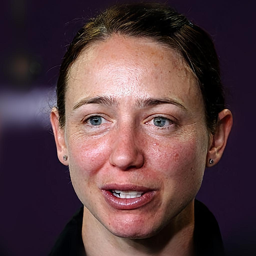

In [24]:
original_image.resize((256, 256))

## Step 5: Perform Inference

### Align Image

Before running inference we'll run alignment on the input image.

In [25]:
!wget http://dlib.net/files/shape_predictor_68_face_landmarks.dat.bz2
!bzip2 -dk shape_predictor_68_face_landmarks.dat.bz2

--2026-01-19 00:55:59--  http://dlib.net/files/shape_predictor_68_face_landmarks.dat.bz2
Resolving dlib.net (dlib.net)... 107.180.26.78
Connecting to dlib.net (dlib.net)|107.180.26.78|:80... connected.
HTTP request sent, awaiting response... 301 Moved Permanently
Location: https://dlib.net/files/shape_predictor_68_face_landmarks.dat.bz2 [following]
--2026-01-19 00:56:00--  https://dlib.net/files/shape_predictor_68_face_landmarks.dat.bz2
Connecting to dlib.net (dlib.net)|107.180.26.78|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 64040097 (61M)
Saving to: ‘shape_predictor_68_face_landmarks.dat.bz2’

shape_predictor_68_ 100%[===================>]  61.07M  47.6MB/s    in 1.3s    

2026-01-19 00:56:01 (47.6 MB/s) - ‘shape_predictor_68_face_landmarks.dat.bz2’ saved [64040097/64040097]



In [26]:
def run_alignment(image_path):
    import dlib
    from scripts.align_all_parallel import align_face
    predictor = dlib.shape_predictor("shape_predictor_68_face_landmarks.dat")
    aligned_image = align_face(filepath=image_path, predictor=predictor)
    print("Aligned image has shape: {}".format(aligned_image.size))
    return aligned_image

In [27]:
aligned_image = run_alignment(image_path)

Aligned image has shape: (256, 256)


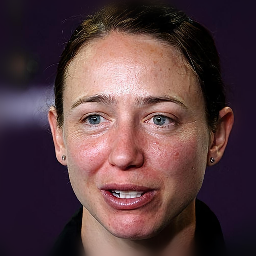

In [28]:
aligned_image.resize((256, 256))

### Run Inference

In [29]:
img_transforms = EXPERIMENT_ARGS['transform']
input_image = img_transforms(aligned_image)

In [30]:
# we'll run the image on multiple target ages
target_ages = [0, 10, 20, 30, 40, 50, 60, 70, 80, 90, 100]
age_transformers = [AgeTransformer(target_age=age) for age in target_ages]

In [31]:
def run_on_batch(inputs, net):
    result_batch = net(inputs.to("cuda").float(), randomize_noise=False, resize=False)
    return result_batch

In [32]:
# for each age transformed age, we'll concatenate the results to display them side-by-side
results = np.array(aligned_image.resize((1024, 1024)))
for age_transformer in age_transformers:
    print(f"Running on target age: {age_transformer.target_age}")
    with torch.no_grad():
        input_image_age = [age_transformer(input_image.cpu()).to('cuda')]
        input_image_age = torch.stack(input_image_age)
        result_tensor = run_on_batch(input_image_age, net)[0]
        result_image = tensor2im(result_tensor)
        results = np.concatenate([results, result_image], axis=1)

Running on target age: 0
Running on target age: 10
Running on target age: 20
Running on target age: 30
Running on target age: 40
Running on target age: 50
Running on target age: 60
Running on target age: 70
Running on target age: 80
Running on target age: 90
Running on target age: 100


### Visualize Result

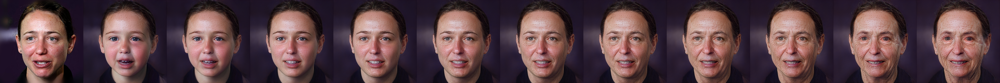

In [33]:
results = Image.fromarray(results)
results   # this is a very large image (11*1024 x 1024) so it may take some time to display!

In [34]:
# save image at full resolution
results.save("notebooks/images/age_transformed_image.jpg")